In [1]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
import cv2
import torch
from torchvision import transforms
from PIL import Image, ImageEnhance
from torch.utils.data import Dataset

In [2]:
seed = 123
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [3]:
dataset_paths = {
    "PACS" : os.path.join(os.getcwd(), "PACS", "kfold")
    }

### Dataset Class

The datasets are sampled aftre shuffling. Since the images are distributed among each domain-class group approximately uniformly, a dedicated sampler is not used

In [25]:
class DGDataset(Dataset):
    def __init__(self, root, seed=seed, transform=None):
        random.seed(seed)

        self.root = root
        self.transform = transform
        self.path_list = []
        self.domain_to_idx = {}

        # Traverse directory structure
        domains = sorted([d for d in os.listdir(root) if os.path.isdir(os.path.join(root, d))])
        for domain_idx, domain in enumerate(domains):
            self.domain_to_idx[domain] = domain_idx
            domain_path = os.path.join(root, domain)

            classes = sorted([c for c in os.listdir(domain_path) if os.path.isdir(os.path.join(domain_path, c))])
            for cls in classes:
                class_path = os.path.join(domain_path, cls)
                img_filenames = [
                    f for f in os.listdir(class_path)
                    if f.lower().endswith(('.jpg', '.jpeg', '.png'))
                ]
                for img in img_filenames:
                    self.path_list.append({
                        "path": os.path.join(class_path, img),
                        "domain": domain,
                        "class": cls
                    })

        random.shuffle(self.path_list)

    def __len__(self):
        return len(self.path_list)

    def __getitem__(self, idx):
        sample = self.path_list[idx]
        img_path = sample["path"]
        domain = sample["domain"]
        domain_idx = self.domain_to_idx[domain]

        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)

        return image, domain_idx


In [26]:
data = DGDataset(root=dataset_paths['PACS']).path_list
random.shuffle(data)
num_samples = 5

## Semantics Preserving Image Transformations

### 1. Fourier Based Transformations

In [27]:
def fft_semantics(img_path, ampl_scale = 0):
    """

    Args:
        - img_path: Image path
        - ampl_scale: (0 - 100) (0, 5, 10, 50, 100)
    Returns:
        - recnostructed_image: np.array
    """
    # Load image (convert to grayscale for simplicity)
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)
    
    reconstructed_channels = []
    
    for c in range(3): # Channels
        channel = img_np[:, :, c]
        
        # FFT 
        fft = np.fft.fft2(channel)
        fft_shifted = np.fft.fftshift(fft)
        
        # Amplitude
        ampl = np.abs(fft_shifted)
        phase = np.angle(fft_shifted)
        
        # Replace amplitude with constant
        const_amp = np.ones_like(ampl) + ampl * 1e-5 * ampl_scale
        
        # Reconstruct with constant amplitude and original phase
        modified_fft = const_amp * np.exp(1j * phase)
        
        # Inverse FFT
        ifft_shifted = np.fft.ifftshift(modified_fft)
        reconstructed = np.fft.ifft2(ifft_shifted)
        reconstructed = np.abs(reconstructed)

        # Normalize to 0–255
        reconstructed = 255 * (reconstructed - reconstructed.min()) / (reconstructed.max() - reconstructed.min())
        reconstructed_channels.append(reconstructed.astype(np.uint8))

    # Merge channels back
    reconstructed_img = np.stack(reconstructed_channels, axis=2)
    
    return reconstructed_img

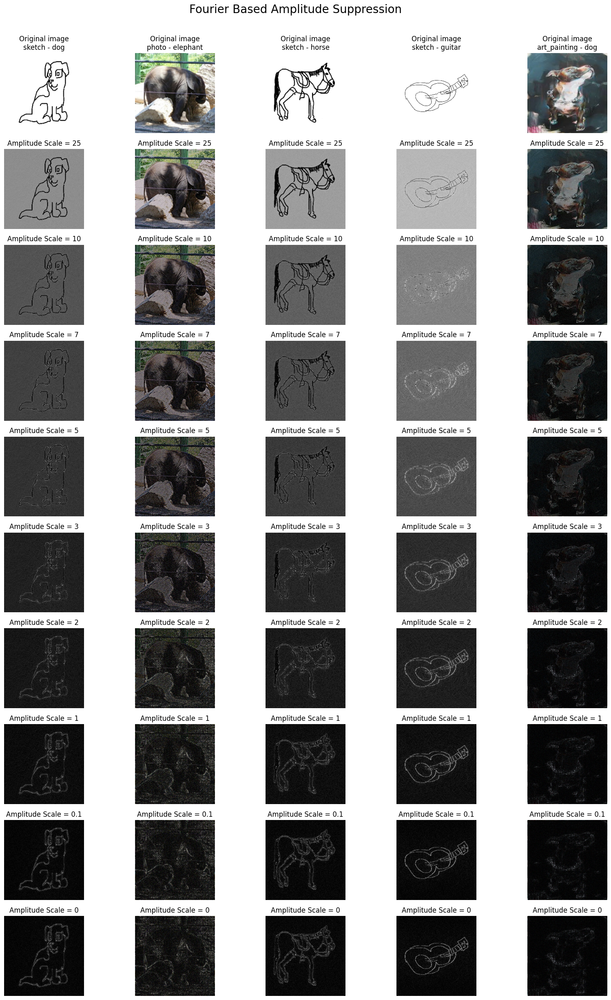

In [28]:
# Visualize output
ampl_scales = [0, 0.1, 1, 2, 3, 5, 7, 10, 25]
img_data = data[:num_samples]

# Plot original vs reconstructed
fig, axes = plt.subplots(len(ampl_scales) + 1, num_samples, figsize=(20, 30))
fig.suptitle("Fourier Based Amplitude Suppression", fontsize=20, y=0.92)
for img_idx, img_datum in enumerate(img_data):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)
    
    title = f'Original image\n{img_domain} - {img_class}'
    axes[0, img_idx].imshow(img_np.astype(np.uint8))
    axes[0, img_idx].set_title(title)
    axes[0, img_idx].axis('off')
    
    for ampl_idx, ampl_scale in enumerate(ampl_scales[::-1]):
        reconstructed_img = fft_semantics(img_path=img_path, ampl_scale=ampl_scale)
        title = f'Amplitude Scale = {ampl_scale}'
        axes[ampl_idx+1, img_idx].imshow(reconstructed_img.astype(np.uint8))
        axes[ampl_idx+1, img_idx].set_title(title)
        axes[ampl_idx+1, img_idx].axis('off')


### 2. Gaussian Blurring

In [29]:
def gaussian_blur_image(img_path, blur_scale=0):
    """
    Apply Gaussian blur to an RGB image with adjustable blur strength.

    Args:
        img_path (str): Path to the image file.
        blur_scale (float): Blur strength (sigma in Gaussian kernel).
                            If 0, returns original image.
    Returns:
        np.ndarray: Blurred image (H, W, 3) in uint8 format.
    """
    # Load image
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    if blur_scale <= 0:
        return img_np  # No blur

    # Kernel size should be odd and depend on blur scale
    ksize = int(max(3, (blur_scale // 2) * 2 + 1))  # Ensure odd kernel
    blurred = cv2.GaussianBlur(img_np, (ksize, ksize), sigmaX=blur_scale)

    return blurred

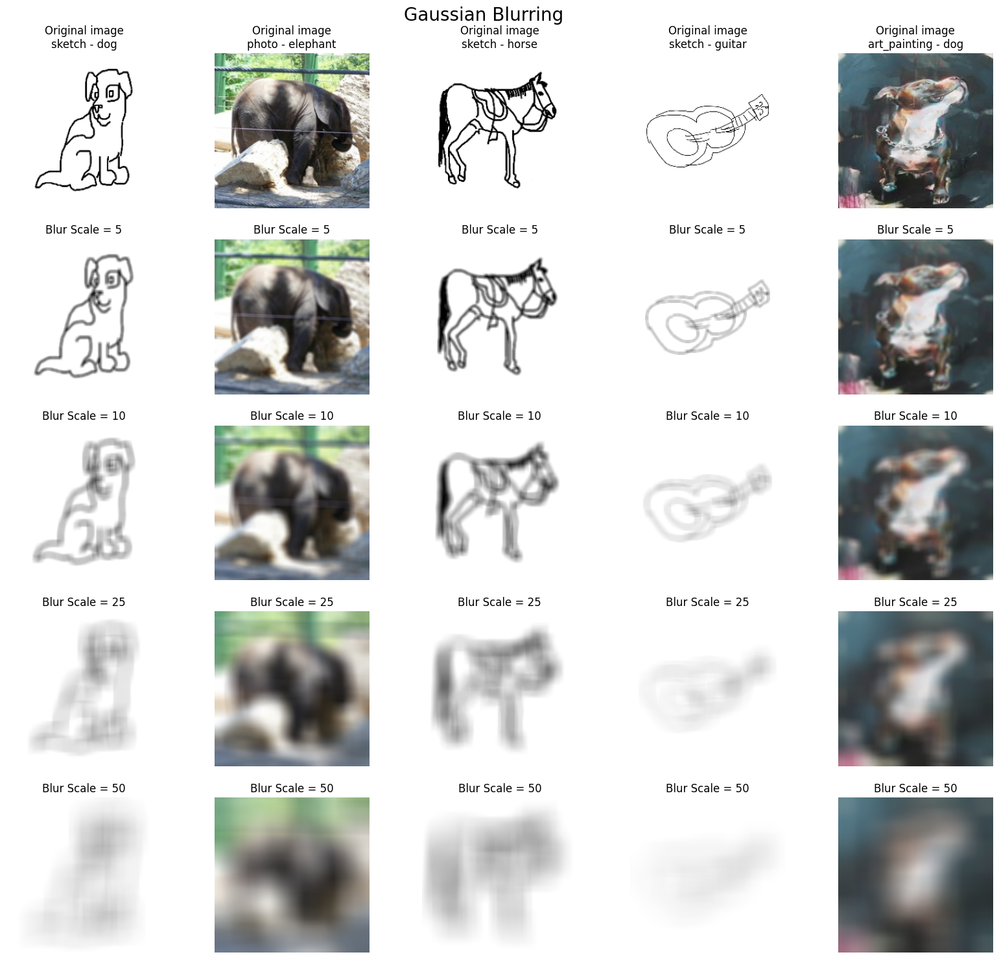

In [30]:
# Visualize output
blur_scales = [0, 5, 10, 25, 50]
img_data = data[:num_samples]

# Plot original vs reconstructed
fig, axes = plt.subplots(len(blur_scales), num_samples, figsize=(20, 18))
fig.suptitle("Gaussian Blurring", fontsize=20, y=0.92)
for img_idx, img_datum in enumerate(img_data):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)
    for blur_idx, blur_scale in enumerate(blur_scales):
        reconstructed_img = gaussian_blur_image(img_path, blur_scale)
        title = f'Original image\n{img_domain} - {img_class}' if blur_scale == 0 else f'Blur Scale = {blur_scale}'
        axes[blur_idx, img_idx].imshow(reconstructed_img.astype(np.uint8))
        axes[blur_idx, img_idx].set_title(title)
        axes[blur_idx, img_idx].axis('off')


### 3. Edges

In [31]:
def canny_edge_image(img_path, edge_scale=100):
    """
    Apply Canny edge detection to an RGB image with adjustable sensitivity.

    Args:
        img_path (str): Path to the image file.
        edge_scale (float): Controls edge detection thresholds.
                            Lower values -> more edges detected.
    Returns:
        np.ndarray: Edge-detected image (H, W, 3) in uint8 format.
                    Returned in RGB (edges are white on black).
    """
    # Load image
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    # Convert to grayscale for Canny
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)

    # Define thresholds based on edge_scale
    lower_thresh = max(0, edge_scale * 0.5)
    upper_thresh = edge_scale

    # Apply Canny edge detector
    edges = cv2.Canny(gray, threshold1=lower_thresh, threshold2=upper_thresh)

    # Convert single-channel edges to 3-channel RGB
    edges_rgb = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)

    return edges_rgb

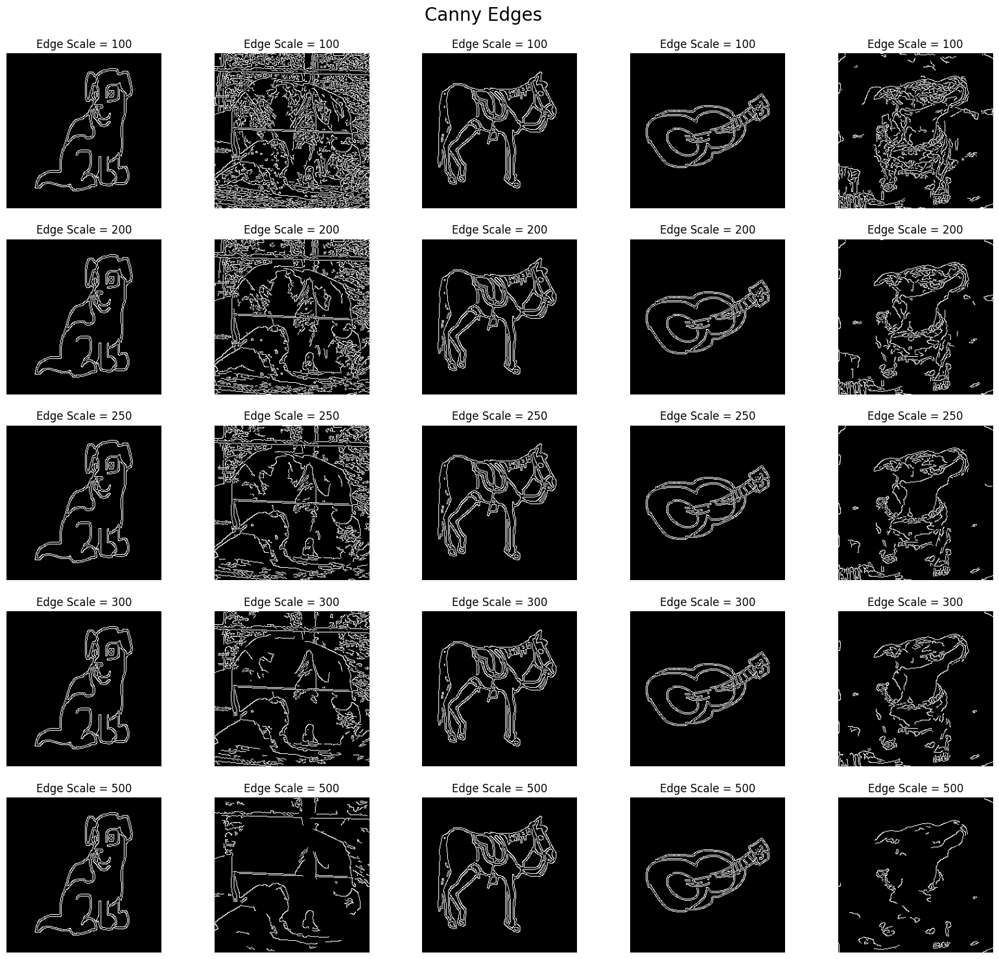

In [32]:
# Visualize output
data = DGDataset(root=dataset_paths['PACS']).path_list
random.shuffle(data)
num_samples = 5
edge_scales = [100, 200, 250, 300, 500]
img_data = data[:num_samples]

# Plot original vs reconstructed
fig, axes = plt.subplots(len(edge_scales), num_samples, figsize=(20, 18))
fig.suptitle("Canny Edges", fontsize=20, y=0.92)
for img_idx, img_datum in enumerate(img_data):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)
    for edge_idx, edge_scale in enumerate(edge_scales):
        reconstructed_img = canny_edge_image(img_path,edge_scale)
        title = f'Edge Scale = {edge_scale}'
        axes[edge_idx, img_idx].imshow(reconstructed_img.astype(np.uint8))
        axes[edge_idx, img_idx].set_title(title)
        axes[edge_idx, img_idx].axis('off') 


### 4. Blurring with Edge Masks

In [33]:
def selective_gaussian_blur(img_path, blur_scale=5, edge_scale=100):
    """
    Apply Gaussian blur only to non-edge regions in an image.

    Args:
        img_path (str): Path to the image file.
        blur_scale (float): Gaussian blur strength (sigma).
        edge_scale (float): Canny edge detection upper threshold.
                            Lower threshold is half of this.
    Returns:
        np.ndarray: Image with edges preserved and non-edge areas blurred (H, W, 3).
    """
    # Load image
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    # --- Step 1: Edge detection ---
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    lower_thresh = max(0, edge_scale * 0.5)
    upper_thresh = edge_scale
    edges = cv2.Canny(gray, threshold1=lower_thresh, threshold2=upper_thresh)

    # Create mask: edges = 1, non-edges = 0
    mask = (edges > 0).astype(np.uint8)

    # --- Step 2: Apply Gaussian blur ---
    ksize = int(max(3, (blur_scale // 2) * 2 + 1))  # odd kernel size
    blurred = cv2.GaussianBlur(img_np, (ksize, ksize), sigmaX=blur_scale)

    # --- Step 3: Combine blurred and original using mask ---
    # Expand mask to 3 channels
    mask_3c = np.repeat(mask[:, :, np.newaxis], 3, axis=2)
    # Invert mask so edges = 1 in original image, 0 in blurred
    inv_mask_3c = 1 - mask_3c

    # Keep edges from original image, blur elsewhere
    output = (img_np * mask_3c) + (blurred * inv_mask_3c)
    output = output.astype(np.uint8)

    return output


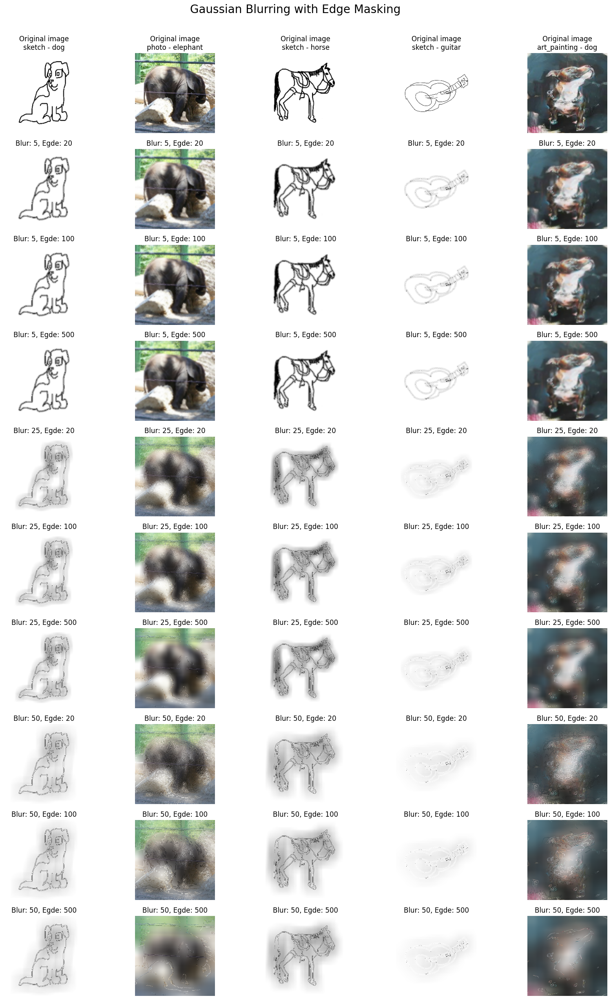

In [34]:
# Visualize output
blur_scales = [5, 25, 50]
edge_scales = [20, 100, 500]
img_data = data[:num_samples]

# Plot original vs reconstructed
fig, axes = plt.subplots(len(blur_scales) * len(edge_scales) + 1, num_samples, figsize=(20, 30))
fig.suptitle("Gaussian Blurring with Edge Masking", fontsize=20, y=0.92)
for img_idx, img_datum in enumerate(img_data):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)
    
    title = f'Original image\n{img_domain} - {img_class}'
    axes[0, img_idx].imshow(img_np.astype(np.uint8))
    axes[0, img_idx].set_title(title)
    axes[0, img_idx].axis('off')
    
    for blur_idx, blur_scale in enumerate(blur_scales):
        for edge_idx, edge_scale in enumerate(edge_scales):
            reconstructed_img = selective_gaussian_blur(img_path=img_path, blur_scale=blur_scale, edge_scale=edge_scale)
            title = f'Blur: {blur_scale}, Egde: {edge_scale}'
            axes[blur_idx * len(edge_scales) + edge_idx + 1, img_idx].imshow(reconstructed_img.astype(np.uint8))
            axes[blur_idx * len(edge_scales) + edge_idx + 1, img_idx].set_title(title)
            axes[blur_idx * len(edge_scales) + edge_idx + 1, img_idx].axis('off')

### 5. Color Transformations

In [35]:
def convert_to_grayscale(img_path):
    """
    Convert an RGB image to grayscale but keep 3 identical channels.
    """
    img = Image.open(img_path).convert('L')  # Single-channel grayscale
    img_np = np.array(img, dtype=np.uint8)

    # Stack to 3 channels
    gray_rgb = np.stack([img_np] * 3, axis=2)
    return gray_rgb

def random_shuffle_channels(img_path, seed=None):
    """
    Randomly shuffle the RGB channels of an image.
    """
    if seed is not None:
        random.seed(seed)

    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    channels = [0, 1, 2]
    random.shuffle(channels)
    shuffled_img = img_np[:, :, channels]
    return shuffled_img

def random_drop_channels(img_path, drop_rate=1, seed=None):
    """
    Randomly replace 1 or 2 RGB channels with a constant value (0-255).
    """
    if seed is not None:
        random.seed(seed)

    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    num_drop = random.choice([1, 2])  # Drop either 1 or 2 channels
    channels_to_drop = random.sample([0, 1, 2], num_drop)

    for ch in channels_to_drop:
        constant_val = random.randint(0, 255)
        img_np[:, :, ch] = np.clip(constant_val * drop_rate + img_np[:, :, ch] * (1 - drop_rate), 0, 255)

    return img_np

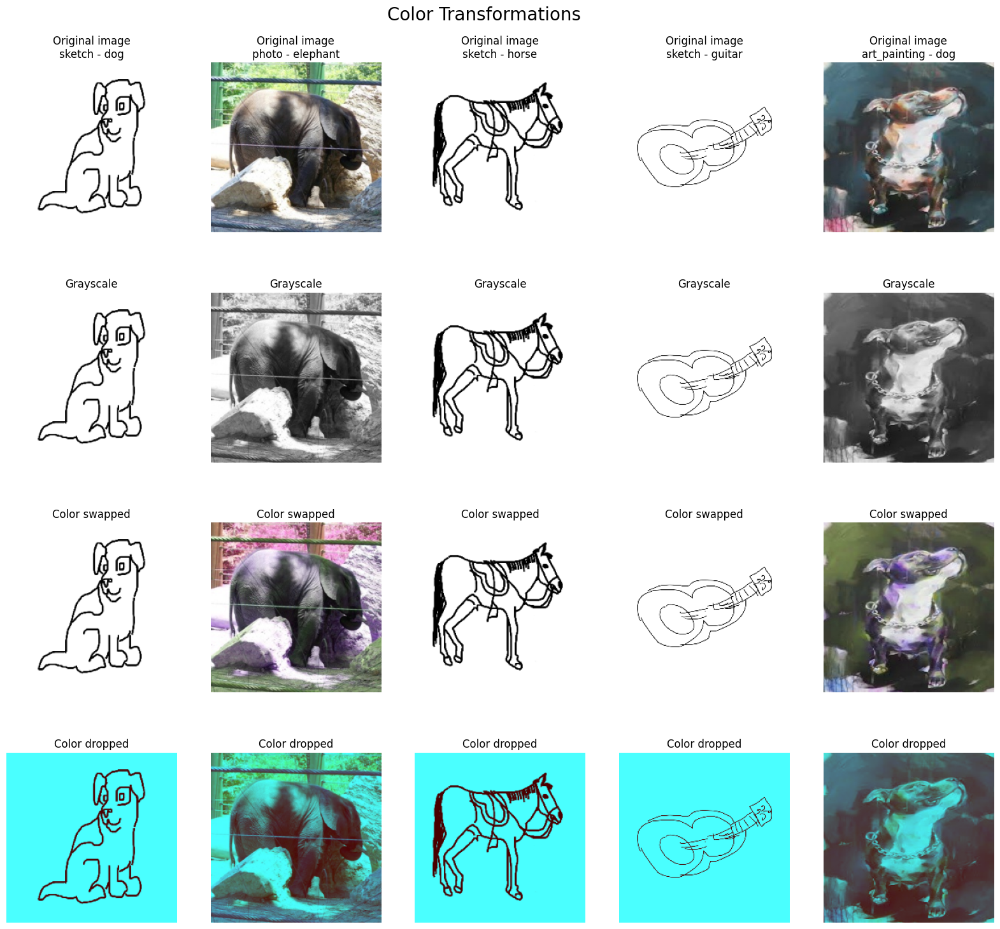

In [36]:
# Visualize output
data = DGDataset(root=dataset_paths['PACS']).path_list
random.shuffle(data)
num_samples = 5
img_data = data[:num_samples]

# Plot original vs reconstructed
fig, axes = plt.subplots(4, num_samples, figsize=(20, 18))
fig.suptitle("Color Transformations", fontsize=20, y=0.92)
for img_idx, img_datum in enumerate(img_data):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)
    
    title = f'Original image\n{img_domain} - {img_class}'
    axes[0, img_idx].imshow(img_np.astype(np.uint8))
    axes[0, img_idx].set_title(title)
    axes[0, img_idx].axis('off')

    title = 'Grayscale'
    grayscale_img = convert_to_grayscale(img_path)
    axes[1, img_idx].imshow(grayscale_img.astype(np.uint8))
    axes[1, img_idx].set_title(title)
    axes[1, img_idx].axis('off')
    
    title = 'Color swapped'
    color_swapped_img = random_shuffle_channels(img_path=img_path, seed=seed)
    axes[2, img_idx].imshow(color_swapped_img.astype(np.uint8))
    axes[2, img_idx].set_title(title)
    axes[2, img_idx].axis('off')
    
    title = 'Color dropped'
    color_dropped_img = random_drop_channels(img_path=img_path, seed=seed)
    axes[3, img_idx].imshow(color_dropped_img.astype(np.uint8))
    axes[3, img_idx].set_title(title)
    axes[3, img_idx].axis('off')

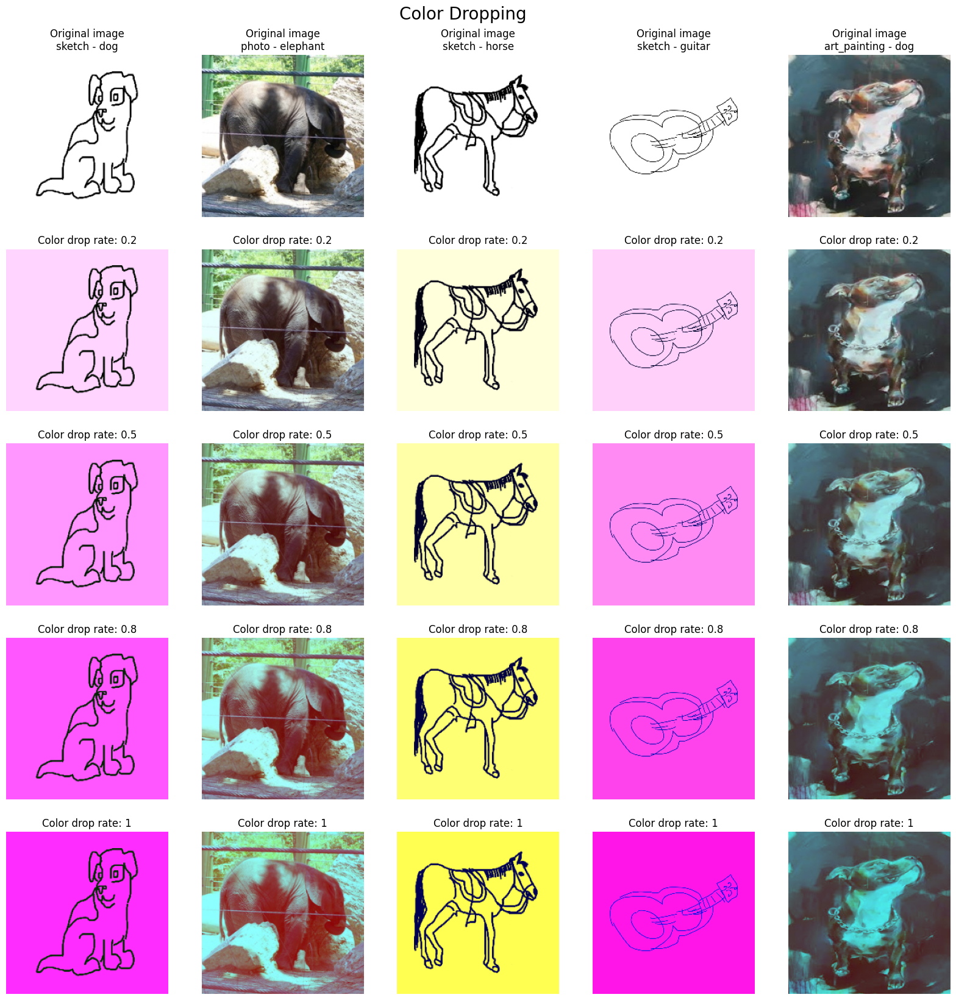

In [37]:
# Visualize colors being dropped gradually
# Visualize output
data = DGDataset(root=dataset_paths['PACS']).path_list
random.shuffle(data)
num_samples = 5
color_drop_rates = [0.2, 0.5, 0.8, 1]
img_data = data[:num_samples]
seeds = [123, 42, 51, 75, 32]

# Plot original vs reconstructed
fig, axes = plt.subplots(len(color_drop_rates) + 1, num_samples, figsize=(20, 20))
fig.suptitle("Color Dropping", fontsize=20, y=0.92)
for (img_idx, img_datum), seed in zip(enumerate(img_data), seeds):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)
    
    title = f'Original image\n{img_domain} - {img_class}'
    axes[0, img_idx].imshow(img_np.astype(np.uint8))
    axes[0, img_idx].set_title(title)
    axes[0, img_idx].axis('off')
    
    for drop_idx, drop_rate in enumerate(color_drop_rates):
        reconstructed_img = random_drop_channels(img_path=img_path, drop_rate=drop_rate, seed=seed)
        title = f'Color drop rate: {drop_rate}'
        axes[drop_idx + 1, img_idx].imshow(reconstructed_img.astype(np.uint8))
        axes[drop_idx + 1, img_idx].set_title(title)
        axes[drop_idx + 1, img_idx].axis('off')

### 6. Color Jitter with Hue, Brightness, Contrast, and Saturation

In [38]:
def random_color_jitter(img_path, brightness=0.5, contrast=0.5, saturation=0.5, hue=0.1, seed=None):
    if seed is not None:
        random.seed(seed)
    img = Image.open(img_path).convert('RGB')

    if brightness > 0:
        img = ImageEnhance.Brightness(img).enhance(1 + random.uniform(-brightness, brightness))
    if contrast > 0:
        img = ImageEnhance.Contrast(img).enhance(1 + random.uniform(-contrast, contrast))
    if saturation > 0:
        img = ImageEnhance.Color(img).enhance(1 + random.uniform(-saturation, saturation))
    if hue > 0:
        hsv = np.array(img.convert("HSV"), dtype=np.uint8)
        hsv[:, :, 0] = (hsv[:, :, 0].astype(int) + int(random.uniform(-hue*255, hue*255))) % 255
        img = Image.fromarray(hsv, "HSV").convert("RGB")

    return np.array(img, dtype=np.uint8)

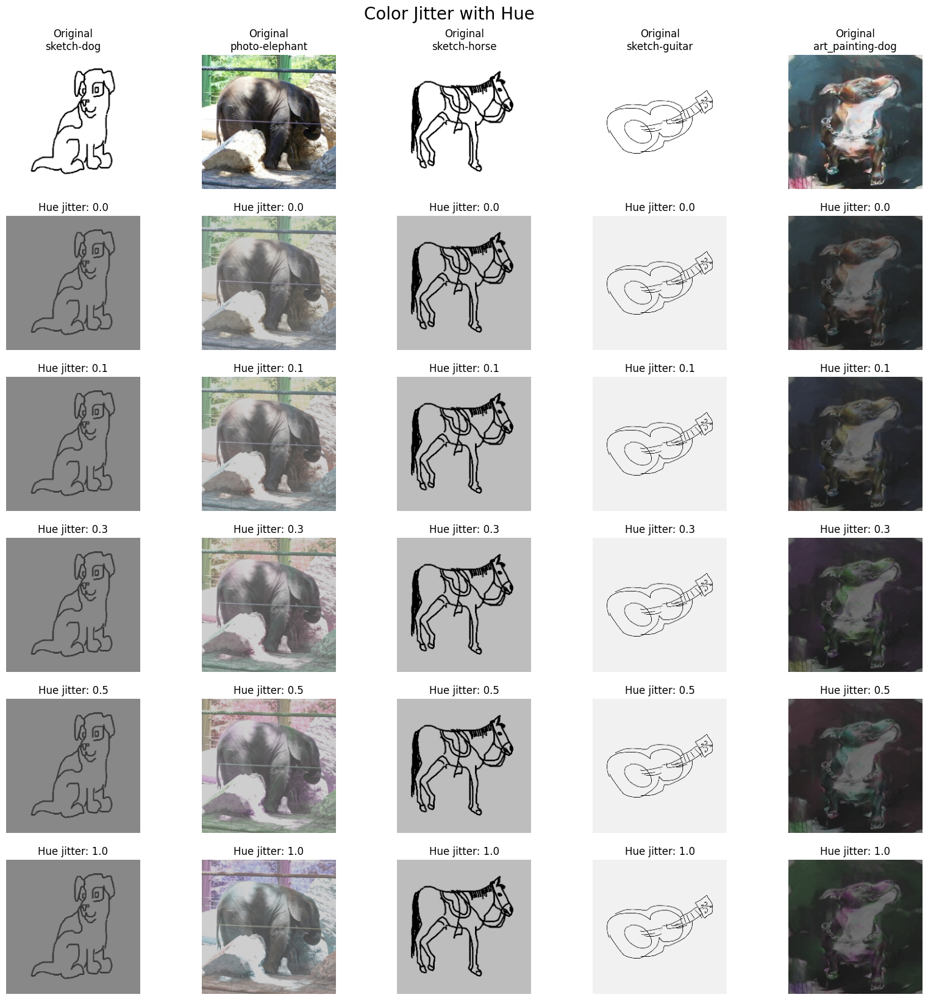

In [39]:
# Visualize color jitter with varying hue
jitter_scales = [0.0, 0.1, 0.3, 0.5, 1.0]
img_data = data[:num_samples]

fig, axes = plt.subplots(len(jitter_scales) + 1, num_samples, figsize=(20, 20))
fig.suptitle("Color Jitter with Hue", fontsize=20, y=0.92)
for (img_idx, img_datum), seed in zip(enumerate(img_data), seeds):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    axes[0, img_idx].imshow(img_np)
    axes[0, img_idx].set_title(f'Original\n{img_domain}-{img_class}')
    axes[0, img_idx].axis('off')

    for jit_idx, hue_val in enumerate(jitter_scales):
        transformed = random_color_jitter(img_path, hue=hue_val, seed=seed)
        axes[jit_idx + 1, img_idx].imshow(transformed)
        axes[jit_idx + 1, img_idx].set_title(f'Hue jitter: {hue_val}')
        axes[jit_idx + 1, img_idx].axis('off')

### 7. Histogram Equalization

In [40]:
def apply_clahe(img_path, clip_limit=2.0, tile_grid_size=(8,8)):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    l = clahe.apply(l)
    lab = cv2.merge((l, a, b))
    return cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)

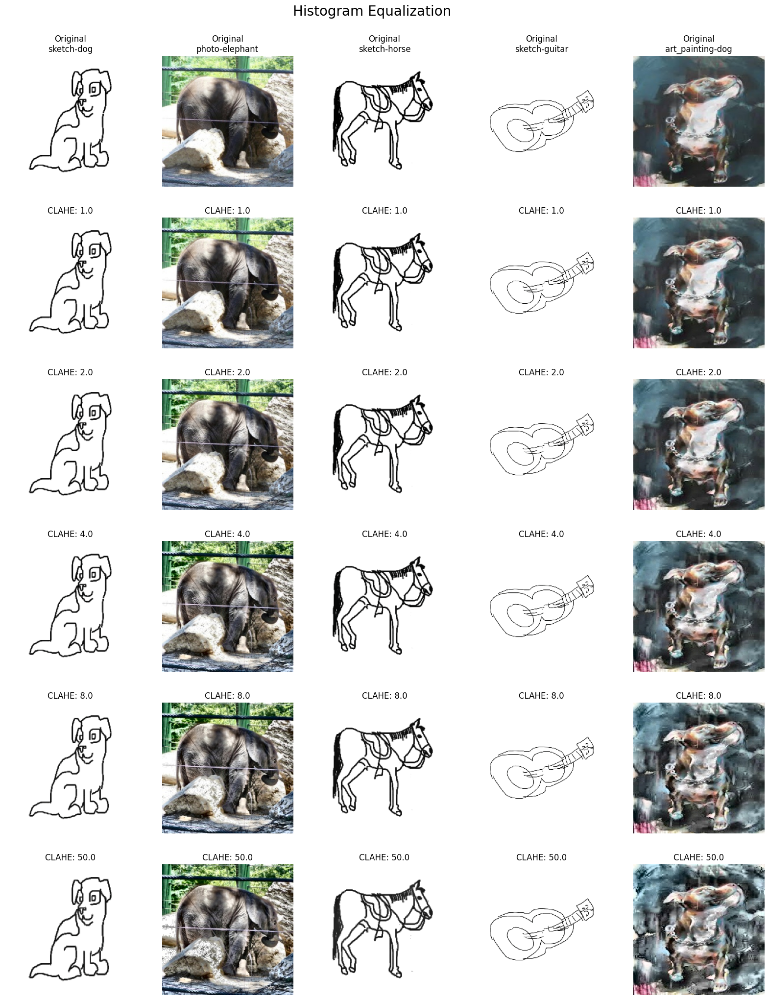

In [41]:
clahe_limits = [1.0, 2.0, 4.0, 8.0, 50.0]
fig, axes = plt.subplots(len(clahe_limits) + 1, num_samples, figsize=(20, 25))
fig.suptitle("Histogram Equalization", fontsize=20, y=0.92)

for (img_idx, img_datum) in enumerate(img_data):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    axes[0, img_idx].imshow(img_np)
    axes[0, img_idx].set_title(f'Original\n{img_domain}-{img_class}')
    axes[0, img_idx].axis('off')

    for c_idx, clip_val in enumerate(clahe_limits):
        transformed = apply_clahe(img_path, clip_limit=clip_val)
        axes[c_idx + 1, img_idx].imshow(transformed)
        axes[c_idx + 1, img_idx].set_title(f'CLAHE: {clip_val}')
        axes[c_idx + 1, img_idx].axis('off')

### Random Channel Normalization

In [42]:
def random_channel_normalization(img_path, seed=None):
    if seed is not None:
        random.seed(seed)
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)

    for c in range(3):
        mean_shift = random.uniform(-50, 50)
        scale_factor = random.uniform(0.5, 1.5)
        img_np[:, :, c] = np.clip((img_np[:, :, c] - img_np[:, :, c].mean()) * scale_factor + mean_shift, 0, 255)
    
    return img_np.astype(np.uint8)

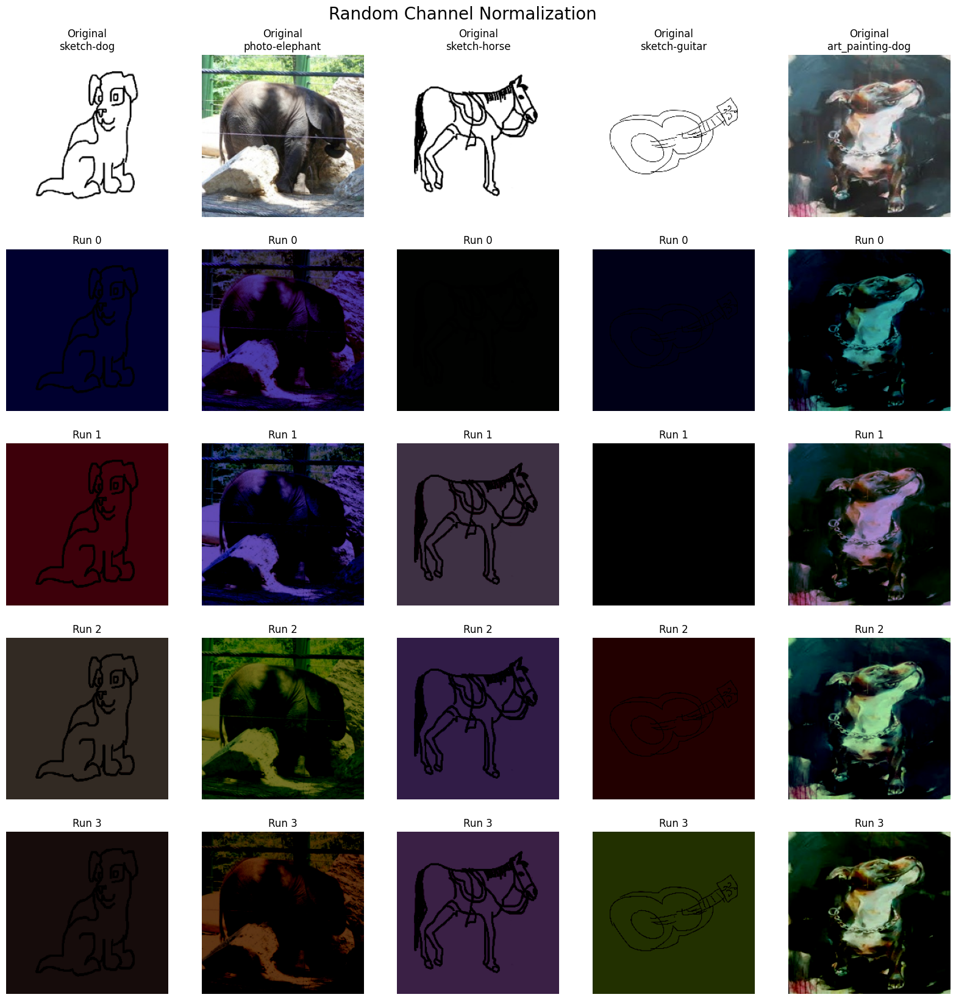

In [43]:
norm_runs = [0, 1, 2, 3]
fig, axes = plt.subplots(len(norm_runs) + 1, num_samples, figsize=(20, 20))
fig.suptitle("Random Channel Normalization", fontsize=20, y=0.92)

for (img_idx, img_datum), seed in zip(enumerate(img_data), seeds):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)

    axes[0, img_idx].imshow(img_np)
    axes[0, img_idx].set_title(f'Original\n{img_domain}-{img_class}')
    axes[0, img_idx].axis('off')

    for n_idx, run in enumerate(norm_runs):
        transformed = random_channel_normalization(img_path, seed=seed+run)
        axes[n_idx + 1, img_idx].imshow(transformed)
        axes[n_idx + 1, img_idx].set_title(f'Run {run}')
        axes[n_idx + 1, img_idx].axis('off')


In [44]:
def low_frequency_noise_injection(img_path, alpha=0.3, blur_kernel=51, seed=None):
    """
    Inject smooth low-frequency noise into an image.

    Args:
        img_path (str): Path to the image.
        alpha (float): Noise blending strength [0,1].
        blur_kernel (int): Size of Gaussian blur kernel (must be odd).
        seed (int): Random seed for reproducibility.
    Returns:
        np.ndarray: Augmented image (uint8).
    """
    if seed is not None:
        np.random.seed(seed)

    # Load image
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.float32)

    # Generate random noise in [0,255]
    noise = np.random.uniform(0, 255, img_np.shape).astype(np.float32)

    # Apply strong Gaussian blur to make it "low-frequency"
    noise = cv2.GaussianBlur(noise, (blur_kernel, blur_kernel), 0)

    # Blend with original image
    blended = np.clip((1 - alpha) * img_np + alpha * noise, 0, 255)

    return blended.astype(np.uint8)

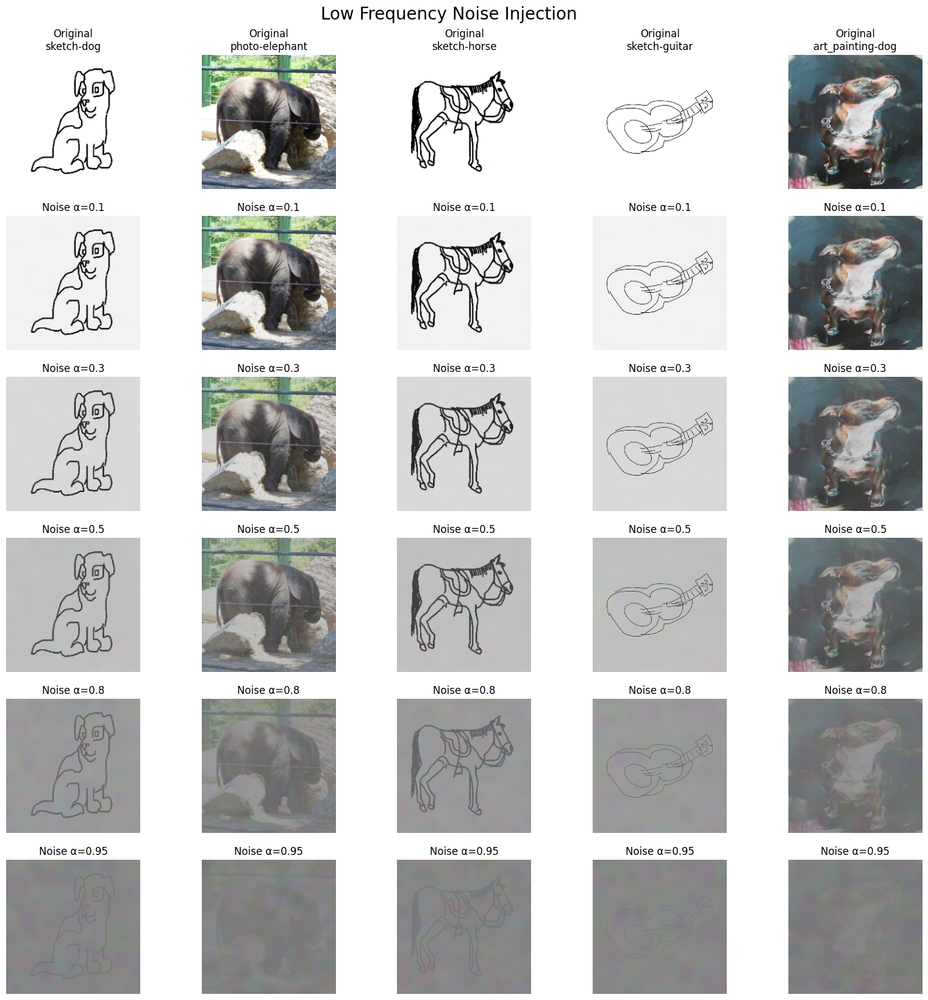

In [45]:
# Parameters for testing
noise_strengths = [0.1, 0.3, 0.5, 0.8, 0.95]
fig, axes = plt.subplots(len(noise_strengths) + 1, num_samples, figsize=(20, 20))
fig.suptitle("Low Frequency Noise Injection", fontsize=20, y=0.92)

for (img_idx, img_datum), seed in zip(enumerate(img_data), seeds):
    img_path = img_datum['path']
    img_domain = img_datum['domain']
    img_class = img_datum['class']

    # Original
    img = Image.open(img_path).convert('RGB')
    img_np = np.array(img, dtype=np.uint8)
    axes[0, img_idx].imshow(img_np)
    axes[0, img_idx].set_title(f'Original\n{img_domain}-{img_class}')
    axes[0, img_idx].axis('off')

    # Different noise levels
    for n_idx, alpha_val in enumerate(noise_strengths):
        transformed = low_frequency_noise_injection(
            img_path, alpha=alpha_val, blur_kernel=51, seed=seed
        )
        axes[n_idx + 1, img_idx].imshow(transformed)
        axes[n_idx + 1, img_idx].set_title(f'Noise α={alpha_val}')
        axes[n_idx + 1, img_idx].axis('off')